In [1]:
# see https://online.kitp.ucsb.edu/online/blayers18/menemenlis/pdf/Menemenlis_BLayers18_KITP.pdf

In [1]:
# Setup Distributed Client
autostart = True
if autostart:
    pass # just let it use the dask lab extension cluster
else:
    from dask.diagnostics import ProgressBar
    from dask.distributed import Client
    from dask.distributed import LocalCluster
    # client = Client('localhost:8787') # Connect to old dashboard?
    try:
        client = Client('tcp://localhost:8786', timeout='2s')
    except OSError:
        cluster = LocalCluster(scheduler_port=8786)
        client = Client(cluster)
client

Client Scheduler: tcp://127.0.0.1:36076 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 6 Cores: 24 Memory: 134.93 GB


In [2]:
#%% Setup Packages
import xarray as xr
from xarray import open_mfdataset
import dask
import dask.array as da
import netCDF4 as netcdf
import numpy as np
import datetime
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import cartopy.crs as ccrs
import metpy.calc as mpcalc
from metpy.units import units
from importlib import reload
from joblib import Parallel, delayed
from tqdm.auto import tqdm

import gc
_ = gc.collect()

import sys
import os

sys.path.insert(1,r"/export/home1/jbenjami/Research_Thompson/Python/personal/")
print(sys.path)
import personal

import personal.math as pm
import personal.data_structures
import personal.date_operations
import personal.SMODE
import personal.plots
import personal.statistics

#%% Plot setup
dpi = 100
from matplotlib.axes import Axes
from cartopy.mpl.geoaxes import GeoAxes
GeoAxes._pcolormesh_patched = Axes.pcolormesh

file_path        = os.path.abspath(os.path.dirname(''))
data_relpath     = "../Data/LLC4320/smode_region/"
data_source      = os.path.normpath(os.path.join(file_path, data_relpath))

['/export/home1/jbenjami/Research_Thompson/Python', '/export/home1/jbenjami/Research_Thompson/Python/personal/', '/export/home1/jbenjami/anaconda3/lib/python37.zip', '/export/home1/jbenjami/anaconda3/lib/python3.7', '/export/home1/jbenjami/anaconda3/lib/python3.7/lib-dynload', '', '/export/home1/jbenjami/anaconda3/lib/python3.7/site-packages', '/export/home1/jbenjami/anaconda3/lib/python3.7/site-packages/IPython/extensions', '/export/home1/jbenjami/.ipython']


In [51]:
# Load raw data from 
time_chunk        = 24*7*14
velocity          = xr.open_mfdataset(data_source +'/velocity/.raw/*.h5', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
velocity          = velocity.rename({'lat':'latg','lon':'long','U':'u','V':'v'})
velocity          = velocity.assign_coords({'lat':velocity['latg'][:,0].values,'lon':velocity['long'][0,:].values,'time':np.arange(np.datetime64('2011-12-01 00:00'), np.datetime64('2012-11-01 00:00'), np.timedelta64(1,'h'))})
velocity          = velocity.rename({'phony_dim_0':'lat','phony_dim_1':'lon','phony_dim_2':'time' })
velocity          = velocity.transpose('time','lat','lon')

# coords_is_land    = personal.geospatial.is_land(velocity['long'],velocity['latg']) # should be good, but doesnt match as well with the data as method below (nan loading as 0 for some reason)

coords_is_land    = np.all((np.all(velocity['u']==0, axis=0), np.all(velocity['v']==0, axis=0)), axis=0) # if both u and v are 0 for all time, classify as land
velocity          = velocity.where(~coords_is_land) # keep non land values, set land to nan
velocity

<xarray.Dataset>
Dimensions:  (lat: 391, lon: 264, time: 8064)
Coordinates:
  * lat      (lat) float32 33.997746 34.013664 34.02958 ... 39.97177 39.986557
  * lon      (lon) float32 -127.010414 -126.989586 ... -121.552086 -121.53125
  * time     (time) datetime64[ns] 2011-12-01 ... 2012-10-31T23:00:00
Data variables:
    u        (time, lat, lon) float32 dask.array<chunksize=(8064, 391, 264), meta=np.ndarray>
    latg     (lat, lon) float32 dask.array<chunksize=(391, 264), meta=np.ndarray>
    long     (lat, lon) float32 dask.array<chunksize=(391, 264), meta=np.ndarray>
    v        (time, lat, lon) float32 dask.array<chunksize=(8064, 391, 264), meta=np.ndarray>

In [52]:
# save regular velocity data
outpath  = data_source + '/velocity/'
_ = personal.data_structures.xr_save_by_date_strtfmt(velocity.compute(),filepath=outpath, filename_prefix='LLC4320_SMODE_Region_2km_Resolution_Hourly_Velocity',return_filenames_datasets=True)

In [3]:
# load regular velocity data
LLC4320_data = xr.open_mfdataset(data_source + '/velocity/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
LLC4320_data_mp = LLC4320_data.metpy.parse_cf()

Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable
Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable


In [54]:
# Save smoothed velocity (we should do most of the analysis with smoothed data, smooth in u,v first because derivative properties may not have the same positive/negative ranges/distributions
time_smoothing = 24 # smoothed 24 hours in case of gravity waves
outpath  = data_source + '/smoothed/velocity/'
out      = LLC4320_data.chunk({'time':48}).rolling(time=time_smoothing,center=True,min_periods=1).mean() 
_ = personal.data_structures.xr_save_by_date_strtfmt(out.compute(),filepath=outpath, filename_prefix='LLC4320_SMODE_Region_2km_Resolution_Hourly_Velocity',return_filenames_datasets=True) # much faster to compute and roll on

In [4]:
# Load smoothed velocity
LLC4320_data_smoothed = xr.open_mfdataset(data_source + '/smoothed/velocity/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
LLC4320_data_smoothed_mp = LLC4320_data_smoothed.metpy.parse_cf()

Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable
Found latitude/longitude values, assuming latitude_longitude for projection grid_mapping variable


In [6]:
def do_rolling(data, window=1, axis=0, min_count=1, center=True, parallel_args={'n_jobs':200,'require':'sharedmem'}):
    # helper fcn to do rolling
    L  = len(data['time'])
    
    def process(i, groups, out):
        out[i] = groups[i].compute()
        return out
    
    roll_groups = personal.data_structures.rolling_groups(data, axis=axis, min_count=min_count, window=window, center=center)
    roll_groups = [x.mean('time',keepdims=False) for x in roll_groups ]    

    out = [None] * L
    Parallel(**parallel_args, verbose=0)(delayed(process)(i, roll_groups, out) for i in tqdm(range(L)))
    _=gc.collect()
    return xr.concat(out,dim='time').assign_coords({'time':data['time']})

In [5]:
# Kinetic Energy normal (Calculate speed/KE per unit mass)
reload(personal.statistics)
energy          = LLC4320_data_mp[['u','v']]

# do EKE
# t_year = 24 * 365
# lt = len(energy['time'])

# Avoided doing subtracting each year's mean or something like that etc since it could lead to discontinuities in EKE etc. implement rolling mean optimitzed with tracking (see comments in personal.data_structures.rolling_groups) then come back to this
# or switch to zarr and use https://github.com/pangeo-data/rechunker , https://rechunker.readthedocs.io/en/latest/
baseline_methods = { None             : (lambda x: x,
                                         lambda x: 0),
                    #'mean year'       : (lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')), # works but seems to fail on saving.... (maybe zarr better)
                    #                     lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')).mean(dim='time') ), # groupby time to make annual cycle (worse than rolling but oh well...)    
                    'all'             : (lambda x: x ,
                                         lambda x: x.mean(dim="time").compute() ),
                    # 'rolling month'   : lambda x: x - do_rolling(x, window = min(t_year//12, lt), parallel_args={'n_jobs':200    ,'require':'sharedmem'} ), # add these back when rolling imiproves
                    # 'rolling season'  : lambda x: x - do_rolling(x, window = min(t_year//4 , lt), parallel_args={'n_jobs':200//4 ,'require':'sharedmem'} ), #
                    # 'rolling year'    : lambda x: x - x - do_rolling(x, window = min(t_year    , lt), parallel_args={'n_jobs':200//12,'require':'sharedmem'} ), #
                   }

u, v = energy['u'], energy['v']

baselines = list(baseline_methods.keys())
out       = dict.fromkeys(baselines)
for baseline in baselines: out[baseline] =  {}

for i,(baseline,method) in enumerate(baseline_methods.items()):
    print('processing baseline : ' + str(baseline))
    out[baseline]['u_p'] = baseline_methods[baseline][0](u) - baseline_methods[baseline][1](u)
    out[baseline]['v_p'] = baseline_methods[baseline][0](v) - baseline_methods[baseline][1](v)
#     print(out[baseline]['u_p'].shape, out[baseline]['v_p'].shape)
    
energy['u_p'] = xr.concat([out[baseline]['u_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))
energy['v_p'] = xr.concat([out[baseline]['v_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))

total           = energy['u_p']**2 + energy['v_p']**2
energy['speed'] = total**(1./2)
energy['KE']    = (1./2) * total
# energy = energy.drop(['u','v','crs','strftime'])
energy = energy.drop(['u','v','crs'])


outpath  = data_source + '/kinetic_energy/'
_ = personal.data_structures.xr_save_by_date_strtfmt(energy.compute(),filepath=outpath, filename_prefix='LLC4320_SMODE_Region_2km_Resolution_Hourly_Kinetic_Energy',return_filenames_datasets=True) # much faster to compute and roll on
_ = gc.collect()

processing baseline : None
processing baseline : all


In [6]:
# Kinetic Energy smoothed (Calculate speed/KE per unit mass)
energy          = LLC4320_data_smoothed_mp[['u','v']]
# do EKE
# t_year = 24 * 365
# lt = len(energy['time'])

# Avoided doing subtracting each year's mean or something like that etc since it could lead to discontinuities in EKE etc. implement rolling mean optimitzed with tracking (see comments in personal.data_structures.rolling_groups) then come back to this
baseline_methods = { None             : (lambda x: x,
                                         lambda x: 0),
#                     'mean year'       : (lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')), # works but seems to fail on saving.... (maybe zarr better)
#                                         lambda x: x.groupby(x.time.dt.strftime('%M-%d %H:%M:%S.%f')).mean(dim='time').compute() ), # groupby time to make annual cycle (worse than rolling but oh well...)    
                    'all'             : (lambda x: x ,
                                         lambda x: x.mean(dim="time").compute() ),
                    # 'rolling month'   : lambda x: x - do_rolling(x, window = min(t_year//12, lt), parallel_args={'n_jobs':200    ,'require':'sharedmem'} ), # add these back when rolling imiproves
                    # 'rolling season'  : lambda x: x - do_rolling(x, window = min(t_year//4 , lt), parallel_args={'n_jobs':200//4 ,'require':'sharedmem'} ), #
                    # 'rolling year'    : lambda x: x - x - do_rolling(x, window = min(t_year    , lt), parallel_args={'n_jobs':200//12,'require':'sharedmem'} ), #
                   }

u, v = energy['u'], energy['v']

baselines = list(baseline_methods.keys())
out       = dict.fromkeys(baselines)
for baseline in baselines: out[baseline] =  {}

for i,(baseline,method) in enumerate(baseline_methods.items()):
    print('processing baseline : ' + str(baseline))
    out[baseline]['u_p'] = baseline_methods[baseline][0](u) - baseline_methods[baseline][1](u)
    out[baseline]['v_p'] = baseline_methods[baseline][0](v) - baseline_methods[baseline][1](v)
#     print(out[baseline]['u_p'].shape, out[baseline]['v_p'].shape)
    
energy['u_p'] = xr.concat([out[baseline]['u_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))
energy['v_p'] = xr.concat([out[baseline]['v_p'] for baseline in baselines], dim='baseline').assign_coords({'baseline':baselines}).transpose(*(...,'baseline'))

total           = energy['u_p']**2 + energy['v_p']**2
energy['speed'] = total**(1./2)
energy['KE']    = (1./2) * total
# energy = energy.drop(['u','v','crs','strftime'])
energy = energy.drop(['u','v','crs'])

outpath  = data_source + '/smoothed/kinetic_energy/'
_ = personal.data_structures.xr_save_by_date_strtfmt(energy.compute(),filepath=outpath, filename_prefix='LLC4320_SMODE_Region_2km_Resolution_Hourly_Kinetic_Energy',return_filenames_datasets=True) # much faster to compute and roll on
_ = gc.collect()

processing baseline : None
processing baseline : all


In [5]:
# Calculate Gradients (dim order is time,lat,lon so this should be the same as for smode data)
def calc_gradients(data,time_chunk=24, dims={'t':0,'y':1,'x':2},parallel_args = {'n_jobs':5,'require':'sharedmem'},verbose=True,progres_bar=True,mmap_input=False,mmap_output=False,parallelize=True):
#     dx, dy = mpcalc.grid_deltas_from_dataarray(data['u'])
    dx, dy = mpcalc.lat_lon_grid_deltas(data.lon.values,data.lat.values) # we havent the degrees east metadata to rely on :/, so gotta load values
    dx = np.expand_dims(dx,0)
    dy = np.expand_dims(dy,0)
    y      = pm.dq_to_q(np.array(dy),dims['y'])
    x      = pm.dq_to_q(np.array(dx),dims['x'])
    t      = np.arange(len(data.time))

    def F(inds,data=data,x=x,y=y,dims=dims):
        u = data['u'][inds].values
        v = data['v'][inds].values
        m = 0 # no shift since  no parllelization and so no  slices lose a dimension
        out = pm.Jacobian({1:u,2:v},deriv_dims=[1-m,2-m],coord_arrays={1-m:y,2-m:x},method='npgradient',periodic=False) # note /dy is going first, then /dx from deriv_dims/coord_arrays, but du/ first then dy/ from {}
        # out = np.stack([out[1][1-m],out[1][2-m],out[2][1-m],out[2][2-m]],axis=3-m) # stack along new axis, from numpy index order [[1,2],[3,4]] = [[du/dy, du/dx], [dv/dy, dv/dx]] (old, deprecated, incorrect)
        out = np.stack([out[1][2-m],out[1][1-m],out[2][2-m],out[2][1-m]],axis=3-m) # stack along new axis, from numpy index order [[1,2],[3,4]] = [[du/dx, du/dy], [dv/dx, dv/dy]]
        return out
    
    Jac = personal.data_structures.apply_in_chunks(  F,
                                                     t,
                                                     output_shape       = data['u'].shape + (4,),
                                                     input_chunk_sizes  = {0:time_chunk},
                                                     output_chunk_sizes = {0:time_chunk}, # defaults to 1 for others
                                                     parallelize        = parallelize,
                                                     parallel_args      = parallel_args,
                                                     progress_bar       = progres_bar,
                                                     verbose            = verbose,
                                                     mmap_input         = mmap_input,
                                                     mmap_output        = mmap_output,
                                                     fcn_kwargs         = {'data': data.compute()})

    new_coords = {'time':data['u'].coords['time'], 'lon':data['u'].coords['lon'], 'lat':data['u'].coords['lat'], 'deriv': ['dudx','dudy','dvdx','dvdy']}
    new_dims   = data['u'].dims + ('deriv',)
    Jac = xr.DataArray(Jac,coords=new_coords,dims=new_dims).astype('float32')
    Jac = Jac.where(np.abs(Jac) != np.inf) # replace inf w/ nan
    return Jac.to_dataset(name='gradients')

In [9]:
# Load kinetic energy
kinetic_energy = xr.open_mfdataset(data_source + '/kinetic_energy/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
kinetic_energy.baseline

In [14]:
kinetic_energy['KE']

,Array,Chunk
Bytes,6.66 GB,19.82 MB
Shape,"(8064, 391, 264, 2)","(24, 391, 264, 2)"
Count,1008 Tasks,336 Chunks
Type,float32,numpy.ndarray


In [6]:
# Gradients normal
tchunk = 24*10
njobs = 20
outpath  = data_source + '/gradients/'
Jac = calc_gradients(LLC4320_data_mp,verbose=True,time_chunk=tchunk, parallel_args={'n_jobs':njobs,'require':'sharedmem'},mmap_input=False,mmap_output=True)
Jac['vorticity']          = Jac['gradients'].sel(deriv='dvdx') - Jac['gradients'].sel(deriv='dudy')  # dv/dx - du/dy
Jac['divergence']         = Jac['gradients'].sel(deriv='dudx') + Jac['gradients'].sel(deriv='dvdy')  # du/dx + dv/dy
Jac['shear_strain_rate']  = Jac['gradients'].sel(deriv='dvdx') + Jac['gradients'].sel(deriv='dudy')  # dv/dx + du/dy
Jac['normal_strain_rate'] = Jac['gradients'].sel(deriv='dudx') - Jac['gradients'].sel(deriv='dvdy')  # du/dx - dv/dy
Jac['strain_rate']        = (Jac['normal_strain_rate']**2 + Jac['shear_strain_rate']**2)**(1./2)
personal.data_structures.xr_save_by_date_strtfmt(Jac,filepath=outpath, filename_prefix='LLC4320_SMODE_Region_2km_Resolution_Hourly_Gradients',return_filenames_datasets=True) # much faster to compute and roll on
_=gc.collect()

running in parallel with 34 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


In [7]:
# Gradients smoothed
tchunk = 24*10
njobs = 20
outpath  = data_source + '/smoothed/gradients/'
Jac = calc_gradients(LLC4320_data_smoothed_mp,verbose=True,time_chunk=tchunk, parallel_args={'n_jobs':njobs,'require':'sharedmem'},mmap_input=False,mmap_output=True)
Jac['vorticity']          = Jac['gradients'].sel(deriv='dvdx') - Jac['gradients'].sel(deriv='dudy')  # dv/dx - du/dy
Jac['divergence']         = Jac['gradients'].sel(deriv='dudx') + Jac['gradients'].sel(deriv='dvdy')  # du/dx + dv/dy
Jac['shear_strain_rate']  = Jac['gradients'].sel(deriv='dvdx') + Jac['gradients'].sel(deriv='dudy')  # dv/dx + du/dy
Jac['normal_strain_rate'] = Jac['gradients'].sel(deriv='dudx') - Jac['gradients'].sel(deriv='dvdy')  # du/dx - dv/dy
Jac['strain_rate']        = (Jac['normal_strain_rate']**2 + Jac['shear_strain_rate']**2)**(1./2)
personal.data_structures.xr_save_by_date_strtfmt(Jac,filepath=outpath, filename_prefix='LLC4320_SMODE_Region_2km_Resolution_Hourly_Gradients',return_filenames_datasets=True) # much faster to compute and roll on
_=gc.collect()

running in parallel with 34 chunks, over 20 jobs
Parallel arguments: {'n_jobs': 20, 'require': 'sharedmem'}
handling folder...

...cleaning up


In [9]:
# Load regular gradients from regular location
gradients        = xr.open_mfdataset(data_source+'/gradients/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
gradients

,Array,Chunk
Bytes,13.32 GB,39.64 MB
Shape,"(8064, 391, 264, 4)","(24, 391, 264, 4)"
Count,1008 Tasks,336 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,3.33 GB,9.91 MB
Shape,"(8064, 391, 264)","(24, 391, 264)"
Count,1008 Tasks,336 Chunks
Type,float32,numpy.ndarray
,Array,Chunk


In [10]:
# Load smoothed  gradients from regular location
gradients_smoothed  = xr.open_mfdataset(data_source+'/smoothed/gradients/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
gradients_smoothed

,Array,Chunk
Bytes,13.32 GB,39.64 MB
Shape,"(8064, 391, 264, 4)","(24, 391, 264, 4)"
Count,1008 Tasks,336 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,3.33 GB,9.91 MB
Shape,"(8064, 391, 264)","(24, 391, 264)"
Count,1008 Tasks,336 Chunks
Type,float32,numpy.ndarray
,Array,Chunk


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
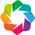

trying to get projection from data...
...failed, continuing with no projection
:Dataset   [lat,lon,time,variable]   (stack-7e3efb84b994ab62c9c7d891094b219b)
Rendering with coastlines


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [15]:
# Plot Velocities
reload(personal.plots)
plot_data = LLC4320_data.to_array().to_dataset() # stack to get better variable browser in menu on right
personal.plots.data_map_viewer(plot_data, projection=None,clim=(-.3,.3),  cmap = None,  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
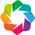

trying to get projection from data...
...failed, continuing with no projection
:Dataset   [lat,lon,time,variable]   (stack-2c63f9ac01a636ebdc2039fa28ddccea)
Rendering with coastlines


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [14]:

reload(personal.plots)
plot_data = LLC4320_data_smoothed.to_array().to_dataset() # stack to get better variable browser in menu on right
personal.plots.data_map_viewer(plot_data, projection=None,clim=(-.3,.3),  cmap = None,  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)# Plot smoothed velocities

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
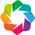

trying to get projection from data...
...failed, continuing with no projection
:Dataset   [deriv,lat,lon,time,variable]   (stack-cd64f55402203c086bb55cb2da824514)
Rendering with coastlines


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [16]:
# plot regular gradients
groups = ('derivatives', 'properties' ,'total strain rate')
plot_data = {groups[0]:gradients[['gradients']].to_array().to_dataset(), groups[1]:gradients[['vorticity','divergence','shear_strain_rate','normal_strain_rate']].to_array().to_dataset(), groups[2]:gradients[['strain_rate']].to_array().to_dataset()}

cmap_0 = LinearSegmentedColormap.from_list("mycmap", [[1,1,1],[0,0,.5],[0,.5,0],'yellow',[1,0,0],'pink'],N=250)
personal.plots.data_map_viewer(plot_data, projection=None,clim={groups[0]:tuple(np.array((-5,5))*10**-5),groups[1]:tuple(np.array((-1,1))*10**-4),groups[2]:tuple(np.array((0,1))*10**-4)},  cmap = {groups[0]:None,groups[1]:None,groups[2]:cmap_0},  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

In [15]:
# plot smoothed gradients
groups = ('derivatives', 'properties' ,'total strain rate')
plot_data = {groups[0]:gradients_smoothed[['gradients']].to_array().to_dataset(), groups[1]:gradients_smoothed[['vorticity','divergence','shear_strain_rate','normal_strain_rate']].to_array().to_dataset(), groups[2]:gradients_smoothed[['strain_rate']].to_array().to_dataset()}

cmap_0 = LinearSegmentedColormap.from_list("mycmap", [[1,1,1],[0,0,.5],[0,.5,0],'yellow',[1,0,0],'pink'],N=250)
personal.plots.data_map_viewer(plot_data, projection=None,clim={groups[0]:tuple(np.array((-5,5))*10**-5),groups[1]:tuple(np.array((-1,1))*10**-4),groups[2]:tuple(np.array((0,1))*10**-4)},  cmap = {groups[0]:None,groups[1]:None,groups[2]:cmap_0},  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

NameError: name 'gradients_smoothed' is not defined

In [29]:
# Load kinetic_energy from regular location
kinetic_energy  = xr.open_mfdataset(data_source+'/kinetic_energy/*.nc*', decode_cf=True, decode_times=True,combine='by_coords',data_vars="minimal", coords="minimal", compat="override",chunks={'time':24},parallel=True) # chunked this way for speed, since we are now just saving calcs to disk... decoding times seems to work, dask chunks for speed
kinetic_energy

,Array,Chunk
Bytes,6.66 GB,19.82 MB
Shape,"(8064, 391, 264, 2)","(24, 391, 264, 2)"
Count,1008 Tasks,336 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,6.66 GB,19.82 MB
Shape,"(8064, 391, 264, 2)","(24, 391, 264, 2)"
Count,1008 Tasks,336 Chunks
Type,float32,numpy.ndarray
,Array,Chunk


In [31]:
kinetic_energy = kinetic_energy.isel(time=np.arange(100,200)).compute()

In [30]:
kinetic_energy[['u_p','v_p']].to_array()

,Array,Chunk
Bytes,13.32 GB,19.82 MB
Shape,"(2, 8064, 391, 264, 2)","(1, 24, 391, 264, 2)"
Count,2688 Tasks,672 Chunks
Type,float32,numpy.ndarray


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
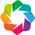

trying to get projection from data...
...failed, continuing with no projection
:Dataset   [baseline,lat,lon,time,variable]   (a)
Rendering with coastlines


Row
    [0] Param(Data_Explorer, expand_button=False)
    [1] ParamMethod(method)

In [38]:
# plot kinetic_energy
groups = ('velocities', 'speed' ,'energy')
plot_data = {groups[0]:kinetic_energy[['u_p','v_p']].to_array().to_dataset(name='a'), groups[1]:kinetic_energy[['speed']].to_array().to_dataset(name='b'), groups[2]:kinetic_energy[['KE']].to_array().to_dataset(name='c')}

cmap_0 = LinearSegmentedColormap.from_list("mycmap", [[1,1,1],[0,0,.5],[0,.5,0],'yellow',[1,0,0],'pink'],N=250)
personal.plots.data_map_viewer(plot_data, projection=None,clim={groups[0]:(-.3,.3),groups[1]:(0,5),groups[2]:(0,.25)},  cmap = {groups[0]:None,groups[1]:cmap_0,groups[2]:cmap_0},  plot_coasts=True,dynamic=True,plot_dims=['lon','lat'],verbose=True)

In [12]:
import gc; gc.collect()
personal.system.print_memory_item_sizes(local_items=locals().items(),n=-1,size_fcn=sys.getsizeof)

                           _i3:  2.5 KiB
                           _i6:  2.5 KiB
                           _i8:  2.5 KiB
                        Client:  2.0 KiB
                ListedColormap:  1.4 KiB
       LinearSegmentedColormap:  1.4 KiB
                           _i4:  1.0 KiB
                          Axes:  1.0 KiB
                       GeoAxes:  1.0 KiB
                           _i5:  552.0 B
                           _i7:  464.0 B
                           _oh:  248.0 B
                           Out:  248.0 B
              baseline_methods:  248.0 B
                           out:  248.0 B
                           _ih:  200.0 B
                            In:  200.0 B
                          _i12:  170.0 B
                open_mfdataset:  144.0 B
                        reload:  144.0 B
                        method:  144.0 B
                     baselines:  136.0 B
                       outpath:  131.0 B
                  LLC4320_data:  120.0 B
               L